# CNN Genre Classification

Ben Sizelove

Supervisor: Shafqat Shad

Data Link:  http://marsyas.info/downloads/datasets.html

In [1]:
import librosa, librosa.display
import matplotlib.pyplot as plt
import numpy as np

# Data Set Information

The dataset consists of 1000 audio tracks each 30 seconds long. It contains 10 genres, each represented by 100 tracks. The tracks are all 22050Hz Mono 16-bit audio files in .wav format.

### Genre Examples

In [2]:
#Blues
import IPython.display as ipd
ipd.Audio('Desktop/senior_project/audio_samples/blues.00000.wav')

In [3]:
#Classical
import IPython.display as ipd
ipd.Audio('Desktop/senior_project/audio_samples/classical.00000.wav')

In [4]:
#Country
import IPython.display as ipd
ipd.Audio('Desktop/senior_project/audio_samples/country.00000.wav')

In [5]:
#Disco
import IPython.display as ipd
ipd.Audio('Desktop/senior_project/audio_samples/disco.00000.wav')

In [6]:
#Hiphop
import IPython.display as ipd
ipd.Audio('Desktop/senior_project/audio_samples/hiphop.00000.wav')

In [7]:
#Jazz
import IPython.display as ipd
ipd.Audio('Desktop/senior_project/audio_samples/jazz.00000.wav')

In [8]:
#Metal
import IPython.display as ipd
ipd.Audio('Desktop/senior_project/audio_samples/metal.00000.wav')

In [9]:
#Pop
import IPython.display as ipd
ipd.Audio('Desktop/senior_project/audio_samples/pop.00000.wav')

In [10]:
#Reggae
import IPython.display as ipd
ipd.Audio('Desktop/senior_project/audio_samples/reggae.00000.wav')

In [11]:
#Rock
import IPython.display as ipd
ipd.Audio('Desktop/senior_project/audio_samples/rock.00000.wav')

## Basics of Audio Data

Sound produces wave forms that have different amplitudes, periods, ect. (Things we may have learned in Calc Classes).

<img src="Desktop/senior_project/wave.png">

When there is a higher frequency, there is also a higher pitch. Also, larger amplitudes are percieved as being louder. 

<img src="Desktop/senior_project/freq.png">

## Blues Sound example

In [12]:
import IPython.display as ipd
ipd.Audio('Desktop/senior_project/audio_samples/blues.00000.wav') # load a local WAV file

In [13]:
file = "Desktop/senior_project/audio_samples/blues.00000.wav"
signal, sr = librosa.load(file,sr=22050)

### Amplitude
- Amplitude tells us how much a specific frequency contributes to an overall sound. Basically shows loudness over time

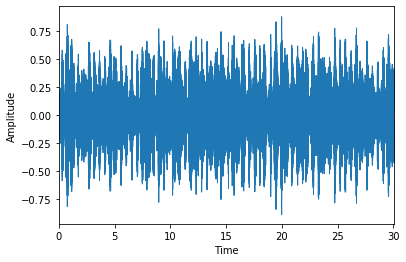

In [14]:
librosa.display.waveplot(signal, sr=sr)
plt.xlabel("Time")
plt.ylabel("Amplitude")
plt.show()

### Fourier Transformation 
- Simplifying a complex soundwave into more specific frequencies. Shows us magnitude as a function of frequency instead as a function of time like the graph above. Unfortuantely, We lose time series information but that will be fixed later using a spectrogram.

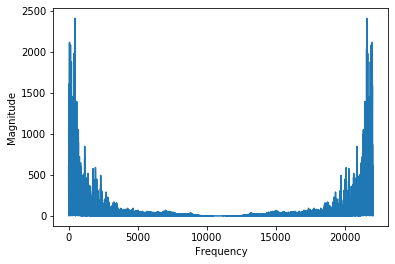

In [15]:
fft = np.fft.fft(signal)
magnitude = np.abs(fft)
frequency = np.linspace(0,sr, len(magnitude))
plt.plot(frequency,magnitude)
plt.xlabel("Frequency")
plt.ylabel("Magnitude")
plt.show()

In [16]:
left_frequency = frequency[:int(len(frequency)/2)]
left_magnitude = magnitude[:int(len(magnitude)/2)]

In this example we can see that most of the energy of the sound is in the lower frequencies. This graph is good but it only averages the energy of the different frequencies througout the sound. Not as useful becuase there is no time series data. We want to understand how frequencies contribute to overall sound throughout the enire duration of the audio sample.

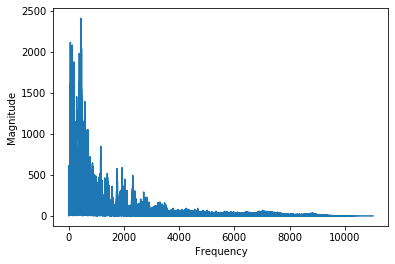

In [17]:
plt.plot(left_frequency,left_magnitude)
plt.xlabel("Frequency")
plt.ylabel("Magnitude")
plt.show()

### Spectrogram
- A spectrogram preserves the time series data while also still including frequency and magnitude information. Magnitude is represented as a function of color. A spectrogram basically takes fourier transformations of the audio data at certain time intervals to preserve magnitude and time information. This spectrogram is what is ultimately useful for deep learning applications like CNN.

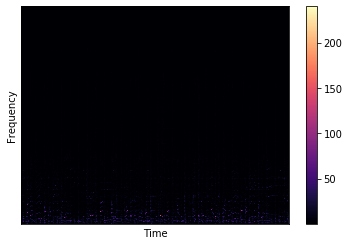

In [18]:
#number of samples considerd in fourier transformations throughout sound
n_fft = 2048
#Shifting fourier transformation through time
hop_length = 512
stft = librosa.core.stft(signal,hop_length = hop_length, n_fft=n_fft)
spectrogram = np.abs(stft)
librosa.display.specshow(spectrogram, sr=sr, hop_length=hop_length)
plt.xlabel("Time")
plt.ylabel("Frequency")
plt.colorbar()
plt.show()

#Frequencies have very low amplitudes
#certain bursts of energy at certain frequencies
#linear representation of loudness
#Amplitude expressed as color

Most of the energy is concentrated in the lower frequencies.

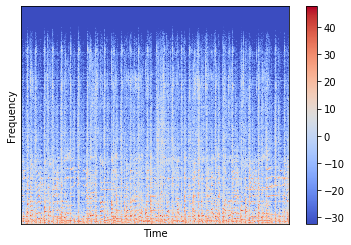

In [19]:
#converting amplitude to decibles


n_fft = 2048
hop_length = 512
stft = librosa.core.stft(signal,hop_length = hop_length, n_fft=n_fft)
spectrogram = np.abs(stft)
log_spectrogram = librosa.amplitude_to_db(spectrogram)

librosa.display.specshow(log_spectrogram, sr=sr, hop_length=hop_length)
plt.xlabel("Time")
plt.ylabel("Frequency")
plt.colorbar()
plt.show()

### Mel Frequency Cepstral Coefficients (MFCCs)
- Captures textural aspects of sounds. MFCC are better at capturing human perception of sound than spectrograms are. More capable of capturing sound quality data. These MFCCs are then put into a deep learning algorithm. This is ultimately what I will be using in my CNN model.

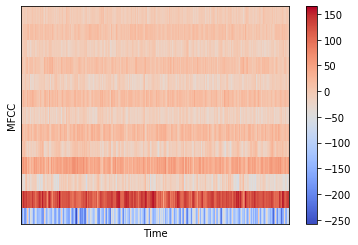

In [20]:
MFFCs = librosa.feature.mfcc(signal, n_fft=n_fft, hop_length=hop_length,n_mfcc=13)
librosa.display.specshow(MFFCs, sr=sr, hop_length=hop_length)
plt.xlabel("Time")
plt.ylabel("MFCC")
plt.colorbar()
plt.show()
#How MFCC evolve overtime.
#MFCC are signals that show features of a sound

# Preparing the Data

In [21]:
import json
import os
import math
import librosa

DATASET_PATH = "Desktop/senior_project/genres"
JSON_PATH = "Desktop/senior_project/audio_with_name_final.json"
SAMPLE_RATE = 22050
TRACK_DURATION = 30 # measured in seconds
SAMPLES_PER_TRACK = SAMPLE_RATE * TRACK_DURATION


def save_mfcc(dataset_path, json_path, num_mfcc=13, n_fft=2048, hop_length=512, num_segments=5):

    # dictionary to store mapping, labels, and MFCCs
    data = {
        "mapping": [],
        "labels": [],
        "mfcc": [],
        "file_name": []
    }

    samples_per_segment = int(SAMPLES_PER_TRACK / num_segments)
    num_mfcc_vectors_per_segment = math.ceil(samples_per_segment / hop_length)

    # loop through all genre sub-folder
    for i, (dirpath, dirnames, filenames) in enumerate(os.walk(dataset_path)):

        # ensure we're processing a genre sub-folder level
        if dirpath is not dataset_path:

            # save genre label (i.e., sub-folder name) in the mapping
            semantic_label = dirpath.split("/")[-1]
            data["mapping"].append(semantic_label)
            print("\nProcessing: {}".format(semantic_label))

            # process all audio files in genre sub-dir
            for f in filenames:

            # load audio file
                file_path = os.path.join(dirpath, f)
                signal, sample_rate = librosa.load(file_path, sr=SAMPLE_RATE)

                # process all segments of audio file
                for d in range(num_segments):

                    # calculate start and finish sample for current segment
                    start = samples_per_segment * d
                    finish = start + samples_per_segment

                    # extract mfcc
                    mfcc = librosa.feature.mfcc(signal[start:finish], sample_rate, n_mfcc=num_mfcc, n_fft=n_fft, hop_length=hop_length)
                    mfcc = mfcc.T

                    # store only mfcc feature with expected number of vectors
                    if len(mfcc) == num_mfcc_vectors_per_segment:
                        data["mfcc"].append(mfcc.tolist())
                        data["labels"].append(i-1)
                        data["file_name"].append(f)
                        print(f)
                        print("{}, segment:{}".format(file_path, d+1))

    # save MFCCs to json file
    with open(json_path, "w") as fp:
        json.dump(data, fp, indent=4)
        
        
#if __name__ == "__main__":
    #save_mfcc(DATASET_PATH, JSON_PATH, num_segments=10)

# CNN Example

In [22]:
import json
import numpy as np
from sklearn.model_selection import train_test_split
import tensorflow.keras as keras
import matplotlib.pyplot as plt

DATA_PATH = "Desktop/senior_project/audio_with_name_final.json"


def load_data(data_path):

    with open(data_path, "r") as fp:
        data = json.load(fp)

    X = np.array(data["mfcc"])
    y = np.array(data["labels"])
    z = np.array(data["file_name"])
    
    return X, y, z


def plot_history(history):

    fig, axs = plt.subplots(2)

    # create accuracy sublpot
    axs[0].plot(history.history["accuracy"], label="train accuracy")
    axs[0].plot(history.history["val_accuracy"], label="test accuracy")
    axs[0].set_ylabel("Accuracy")
    axs[0].legend(loc="lower right")
    axs[0].set_title("Accuracy eval")

    # create error sublpot
    axs[1].plot(history.history["loss"], label="train error")
    axs[1].plot(history.history["val_loss"], label="test error")
    axs[1].set_ylabel("Error")
    axs[1].set_xlabel("Epoch")
    axs[1].legend(loc="upper right")
    axs[1].set_title("Error eval")

    plt.show()


def prepare_datasets(test_size, validation_size):

    # load data
    X, y, z = load_data(DATA_PATH)

    # create train, validation and test split
    X_train, X_test, y_train, y_test, z_train, z_test = train_test_split(X, y, z, test_size=test_size)
    X_train, X_validation, y_train, y_validation, z_train, z_validation = train_test_split(X_train, y_train, z_train, test_size=validation_size)

    # add an axis to input sets
    X_train = X_train[..., np.newaxis]
    X_validation = X_validation[..., np.newaxis]
    X_test = X_test[..., np.newaxis]

    return X_train, X_validation, X_test, y_train, y_validation, y_test, z_train, z_validation, z_test


def build_model(input_shape):
    
    # 3 convolutional Layers followed by Max Pooling
    
    
    # build network topology
    model = keras.Sequential()

    # 1st conv layer
    model.add(keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=input_shape))
    model.add(keras.layers.MaxPooling2D((3, 3), strides=(2, 2), padding='same'))
    model.add(keras.layers.BatchNormalization())

    # 2nd conv layer
    model.add(keras.layers.Conv2D(32, (3, 3), activation='relu'))
    model.add(keras.layers.MaxPooling2D((3, 3), strides=(2, 2), padding='same'))
    model.add(keras.layers.BatchNormalization())

    # 3rd conv layer
    model.add(keras.layers.Conv2D(32, (2, 2), activation='relu'))
    model.add(keras.layers.MaxPooling2D((2, 2), strides=(2, 2), padding='same'))
    model.add(keras.layers.BatchNormalization())

    # flatten output and feed it into dense layer
    model.add(keras.layers.Flatten())
    model.add(keras.layers.Dense(64, activation='relu'))
    model.add(keras.layers.Dropout(0.3))

    # output layer 10 neurons for 10 genres of music
    # Using Softmax
    model.add(keras.layers.Dense(10, activation='softmax'))

    return model



if __name__ == "__main__":

    # get train, validation, test splits
    X_train, X_validation, X_test, y_train, y_validation, y_test, z_train, z_validation, z_test = prepare_datasets(0.25, 0.2)

    # create network
    input_shape = (X_train.shape[1], X_train.shape[2], 1)
    model = build_model(input_shape)

    # compile model
    optimiser = keras.optimizers.Adam(learning_rate=0.0001)
    model.compile(optimizer=optimiser,
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])

    model.summary()

    # train model
    history = model.fit(X_train, y_train, validation_data=(X_validation, y_validation), batch_size=32, epochs=30)

   

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 128, 11, 32)       320       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 64, 6, 32)         0         
_________________________________________________________________
batch_normalization (BatchNo (None, 64, 6, 32)         128       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 62, 4, 32)         9248      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 31, 2, 32)         0         
_________________________________________________________________
batch_normalization_1 (Batch (None, 31, 2, 32)         128       
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 30, 1, 32)         4

# Model Evaluation

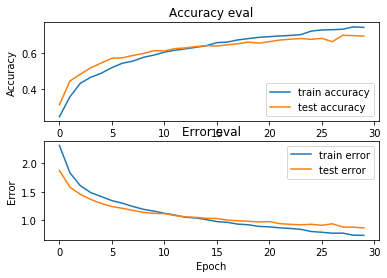

2499/2499 - 1s - loss: 0.8052 - accuracy: 0.7243

Test accuracy: 0.7242897


In [23]:
 # plot accuracy/error for training and validation
plot_history(history)

# evaluate model on test set
test_loss, test_acc = model.evaluate(X_test, y_test, verbose=2)
print('\nTest accuracy:', test_acc)

# Predictions

In [24]:
genre = {0:'pop', 1:'metal', 2:'disco',3:'blues', 4:'reggae', 
             5:'classical',6:'rock', 7:'hiphop', 8:'country', 9:'jazz'}

def predict(model, X, y):

    # add a dimension to input data for sample - model.predict() expects a 4d array in this case
    X = X[np.newaxis, ...] # array shape (1, 130, 13, 1)

    # perform prediction
    prediction = model.predict(X)

    # get index with max value
    predicted_index = np.argmax(prediction, axis=1)
    
    print("Actual genre: {}, Predicted genre: {}".format(genre[y], genre[predicted_index[0]]))
    #print("Actual genre: {}, Predicted genre: {}".format(y, predicted_index[0]))
   

In [48]:
import random

# pick a sample to predict from the test set
# Generate a random sample number within the test set 

# y test contains the actual values
# x test contains the predicted value array
# z test contains the actual file name

random_index = random.randint(0,len(X_test)-1)
X_to_predict = X_test[random_index]
y_to_predict = y_test[random_index]
file_title = z_test[random_index]

#Lets Hear the Prediction!

genre = {0:'pop', 1:'metal', 2:'disco',3:'blues', 4:'reggae', 
            5:'classical',6:'rock', 7:'hiphop', 8:'country', 9:'jazz'}

path_genre = genre[y_test[random_index]]
file_title = z_test[random_index]

predict(model, X_to_predict, y_to_predict)
print("Random Sample prediction index:", random_index)
ipd.Audio("Desktop/senior_project/genres/{}/{}".format(path_genre,file_title))

Actual genre: classical, Predicted genre: classical
Random Sample prediction index: 1933


# Conclusions

- CNN is a great deep learning model for Image data and because of this, audio data is a very interesting application

- The CNN model ended up having around a 70 percent test set accuracy when I run it which I think is pretty good for audio data. The interesting and complicated thing about audio data and genre classification is that there is such a wide range of songs that are classified in the same genres. When we think about music in the real world we can see this type of variation in many different types of music by many different artists.

- One limitation of this type of Model is that it is computationally taxing. It takes a couple of minutes to run the model and it is a relatively small subset of songs. It was also hard to get full song data becauase not all songs are the same length. So in doing another model it would be interesting to have a bigger sample of the sound.

- Some genres seemed to be less accurate when classified while some seemed more accurate. Particularly it seemed that rock and blues were often confused while genres like metal and classical were more often classified correctly. This makes sense to me becauase those are two very distinct genres of music to the human ear.

- The biggest challenge throughout this process was the processing of the data to put into the CNN model. I took a lot of time to track the file names in the JSON so I was able to show the actual sound used in the prediction which was helpful in determining why a sound might have been misclassified. 

- Another way to make this model more accurate would be to include larger samples of songs but its hard to do because full songs obviously vary in length

- This data could also be suitable for other types of Deep learning like RNN becauase there is time series data

- It would also be interesting to apply this model to other audio data such as human language, animals, or any other natural sound samples